In [3]:
import os, sys
sys.path.append(os.path.dirname(os.getcwd()))
sys.path.append(os.path.dirname(os.path.dirname(os.getcwd())))

from glob import glob
import math
from pprint import pprint
import torch

import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import time
import json
import pandas as pd
import random

from tqdm import tqdm
import trimesh

from ANALYSIS.analysis_utils import (
    plot_panel_info,
    visualize_meshes_plotly,
    # v_id_map
)

from env_constants import SEWFORMER_PROJ_ROOT, DATASET_ROOT, PYGARMENT_ROOT

sys.path.append(PYGARMENT_ROOT)

import pygarment as pyg

In [4]:
def filter_fn(path):
    if not os.path.isdir(path):
        print(f"{path} is not a directory")
        return False
    if not os.path.exists(os.path.join(path, "static", "spec_config.json")):
        print(f"No spec_config.json in {path}")
        return False
    return True

raw_combination_path_list = sorted(glob(os.path.join(DATASET_ROOT, "sewfactory", "*")))
combination_path_list = []
for garment_path in tqdm(raw_combination_path_list):
    if filter_fn(garment_path):
        combination_path_list.append(garment_path)
len(combination_path_list)

 42%|████▏     | 815/1954 [00:00<00:00, 4081.20it/s]

No spec_config.json in /Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/dress_sleeveless_M827MSUPRJ
No spec_config.json in /Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/dress_sleeveless_ME7Y3S7MLB
No spec_config.json in /Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/dress_sleeveless_MG7MML3QGT
No spec_config.json in /Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/dress_sleeveless_NIJ4SIHR44
No spec_config.json in /Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/dress_sleeveless_VIXKCSZRM5
No spec_config.json in /Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/jumpsuit_sleeveless_GR6S0C83IQ
No spec_config.json in /Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/jumpsuit_sleeveless_KBMBR543B1
No spec_config.json in /Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/jumpsuit_sleeveless_KM5DJC1GHE
No spec_config.json in /Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/jumpsuit_sleeveless_LCRSE6412S
No spec_config.json in /U

100%|██████████| 1954/1954 [00:00<00:00, 3882.88it/s]

No spec_config.json in /Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/tee_sleeveless_ILE3DX3CEA_pants_straight_sides_NV1DTVFKXW
No spec_config.json in /Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/tee_sleeveless_J4YCBJRYX9_skirt_2_panels_6JUQEONAMD
No spec_config.json in /Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/tee_sleeveless_KFPQ41C0EH_skirt_4_panels_7F901UHMS0
No spec_config.json in /Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/tee_sleeveless_KPCTATGQEL_pants_straight_sides_NGIP24W526
No spec_config.json in /Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/tee_sleeveless_KPS602ZGGQ_skirt_4_panels_O3BNBKW8VJ
No spec_config.json in /Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/tee_sleeveless_LNS3A9GWUB_skirt_2_panels_O9V9JKKQ1Z
No spec_config.json in /Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/tee_sleeveless_LWJ0VGHHZL_wb_pants_straight_XDZBZT0A3W
No spec_config.json in /Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/

1879

- 13706 개의 조함

- garment_path/static/spec_config.json 에 top / bottom / one-piece 정보 있음.
    - top, bottom, one_piece 밖에 없음.
    - {'one_piece': 8269, 'top': 5437, 'bottom': 5437}

- Edge Type 전부 조사
- 전부 반시계방향인지 조사
- sleeve 의 상하좌우가 좀 신기함
- 여기도 panel name 에 숫자가 있는 것들 있음.

- placement_type, panel_count, edge_len count, Edge type 등 전수조사

- Unique 한 패널 Name 별로 몇번 나왔는지 조사 - 여러번 나왔을수도 있잖아
    - 전부 한번씩만 나옴
    - 총 19143 개의 garment

In [3]:
placement_type_count_dict = {}

for combination_path in tqdm(combination_path_list) :
    spec_config_path = os.path.join(combination_path, "static", "spec_config.json")
    with open(spec_config_path, "r") as f:
        spec_config = json.load(open(spec_config_path, "r"))

    for placement_type in spec_config.keys() :
        if placement_type not in placement_type_count_dict :
            placement_type_count_dict[placement_type] = 0
        placement_type_count_dict[placement_type] += 1

print(placement_type_count_dict)

100%|██████████| 1879/1879 [00:00<00:00, 23724.17it/s]

{'one_piece': 1202, 'top': 677, 'bottom': 677}


In [6]:
import random

In [3]:
IDX = random.randint(0, len(combination_path_list))

combination_path = combination_path_list[IDX]
spec_config_path = os.path.join(combination_path, "static", "spec_config.json")
with open(spec_config_path, "r") as f:
    spec_config = json.load(open(spec_config_path, "r"))

print(spec_config.keys())
print(
    list(map(
        lambda x : os.path.basename(x["spec"].replace("\\", "/")),
        spec_config.values()
    ))
)
print(
    list(map(
        os.path.basename,
        glob(os.path.join(garment_path, "static", "*specification.json"))
    ))
)




garment_name_list = list(map(
    lambda x : os.path.basename(x["spec"].replace("\\", "/")),
    spec_config.values()
))

for pos_file in glob(os.path.join(combination_path, "poses", "*.json")) :
    with open(pos_file, "r") as f:
        pos_data = json.load(f)
    print(pos_data.keys())
    print(np.array(pos_data["pose"]).shape)
    print(np.array(pos_data["shape"]).shape)
    print(np.array(pos_data["trans"]).shape)

# with open(os.path.join(combination_path, "static", f"static__body_info.json"), "r") as f:
#     body_info = json.load(f)
# print(body_info.keys())
# pprint(np.array(body_info["pose"]).shape)
# pprint(np.array(body_info["shape"]).shape)
# pprint(np.array(body_info["trans"]).shape)



for garment_name in garment_name_list :
    pprint(
        list(map(
            os.path.basename,
            sorted(glob(os.path.join(
                combination_path, "static", "static*png"
            )))
        ))
    )

dict_keys(['top', 'bottom'])
['tee_sleeveless_692CQR9X06', 'skirt_8_panels_SL3ZZSQ5W4']
['wb_dress_sleeveless_ZXJD88A059_specification.json']
dict_keys(['shape', 'trans', 'pose'])
(52, 3)
(10,)
(3,)
dict_keys(['shape', 'trans', 'pose'])
(52, 3)
(10,)
(3,)
['static_0_30.png',
 'static_120_0.png',
 'static_120_30.png',
 'static_150_0.png',
 'static_150_30.png',
 'static_180_30.png',
 'static_210_0.png',
 'static_210_30.png',
 'static_240_0.png',
 'static_240_30.png',
 'static_270_30.png',
 'static_300_0.png',
 'static_300_30.png',
 'static_30_0.png',
 'static_30_30.png',
 'static_330_0.png',
 'static_330_30.png',
 'static_60_0.png',
 'static_60_30.png',
 'static_90_30.png',
 'static_back.png',
 'static_front.png',
 'static_left.png',
 'static_right.png']
['static_0_30.png',
 'static_120_0.png',
 'static_120_30.png',
 'static_150_0.png',
 'static_150_30.png',
 'static_180_30.png',
 'static_210_0.png',
 'static_210_30.png',
 'static_240_0.png',
 'static_240_30.png',
 'static_270_30.png',
 

In [6]:
from analysis_utils import visualize_meshes_plotly

In [5]:
import json
import numpy as np
import smplx
import torch
import trimesh

SMPLH_PATH = os.path.join(
    SEWFORMER_PROJ_ROOT, "Sewformer", "assets",
)

# Create SMPL-H model
model = smplx.create(
    model_path=SMPLH_PATH,
    model_type='smplh',  # Specifically use SMPL-H
    ext='pkl',
    gender='female',
    use_pca=False,  # Important: disable PCA for hand poses
    batch_size=1,
)

In [7]:
def filter_segmentation_map(mesh, segmentation_list):
    """
    Filter segmentation map by fixing isolated vertices based on their neighbors
    
    Args:
        mesh: trimesh.Trimesh object
        segmentation_list: list of segmentation labels for each vertex
    
    Returns:
        filtered_segmentation_list: list of filtered segmentation labels
    """
    # Convert to numpy array for easier manipulation
    segmentation_array = np.array(segmentation_list)
    filtered_segmentation = segmentation_array.copy()
    
    # Get vertex adjacency
    vertex_neighbors = mesh.vertex_neighbors
    
    # Iterate through vertices
    for vertex_idx in range(len(segmentation_array)):
        current_label = segmentation_array[vertex_idx]
        neighbors = vertex_neighbors[vertex_idx]
        
        if len(neighbors) == 0:
            continue
            
        # Get neighbor labels
        neighbor_labels = segmentation_array[neighbors]
        
        # Count occurrences of each label in neighbors
        unique_labels, counts = np.unique(neighbor_labels, return_counts=True)
        
        # If current vertex label doesn't match majority of neighbors
        if current_label not in neighbor_labels:
            # Replace with most common neighbor label
            filtered_segmentation[vertex_idx] = unique_labels[counts.argmax()]
            
    return filtered_segmentation.tolist()


import numpy as np
import networkx as nx
from scipy.spatial import cKDTree
import trimesh

def filter_segmentation_map_clusters(mesh, segmentation_list, threshold=80):
    """
    Refines the segmentation of a mesh by removing small clusters 
    and replacing them with surrounding dominant segments.
    
    Args:
        mesh: trimesh.Trimesh object representing the garment mesh.
        segmentation_list: List of segment labels for each vertex.
        threshold: Minimum size of a valid cluster. Smaller clusters are reassigned.
    
    Returns:
        A refined segmentation list.
    """
    segmentation_array = np.array(segmentation_list)  # Convert to NumPy array
    
    # Step 1: Build a graph of mesh connectivity
    G = nx.Graph()
    vertices = mesh.vertices
    faces = mesh.faces
    
    for face in faces:
        for i in range(3):
            G.add_edge(face[i], face[(i + 1) % 3])  # Connect face vertices
    
    # Step 2: Find connected components within each segmentation label
    label_to_components = {}
    for label in np.unique(segmentation_array):
        subgraph = G.subgraph([i for i, seg in enumerate(segmentation_array) if seg == label])
        components = list(nx.connected_components(subgraph))
        label_to_components[label] = components
    
    # Step 3: Identify small clusters and reassign them
    refined_segmentation = segmentation_array.copy()
    
    for label, components in label_to_components.items():
        for cluster in components:
            if len(cluster) < threshold:  # If cluster is too small
                # Find neighboring vertices with different segmentation
                neighboring_labels = []
                for vertex in cluster:
                    for neighbor in G.neighbors(vertex):
                        if refined_segmentation[neighbor] != label:
                            neighboring_labels.append(refined_segmentation[neighbor])
                
                if neighboring_labels:
                    # Assign the most frequent neighboring segmentation
                    most_common_label = max(set(neighboring_labels), key=neighboring_labels.count)
                    refined_segmentation[list(cluster)] = most_common_label
    
    return refined_segmentation.tolist()


In [16]:

# Inspect "Static"

IDX = 277
IDX = 918
IDX = 132
IDX = random.randint(0, len(combination_path_list))

print(IDX)
combination_path = combination_path_list[IDX]

# Read Static Camera Information
static_camera_dict = {}
for camera_path in sorted(glob(os.path.join(combination_path, "static", "*cam_pos.json"))):
    with open(camera_path, "r") as f:
        camera_data = json.load(f)
    camera_name = os.path.basename(camera_path).replace("_cam_pos.json", "")
    static_camera_dict[camera_name] = camera_data

# Read Static Body Information
with open(os.path.join(combination_path, "static", "static__body_info.json"), "r") as f:
    static_body_data = json.load(f)
    betas = torch.tensor(static_body_data['shape'], dtype=torch.float32).unsqueeze(0)
    pose = torch.tensor(
        np.deg2rad(static_body_data['pose']),
        dtype=torch.float32
    ).unsqueeze(0)  # Shape: (1, 52, 3)
    transl = torch.tensor(static_body_data['trans'], dtype=torch.float32).unsqueeze(0)

    body_pose = pose[0, 1:22].reshape(1, -1)  # Body joints (excluding global orientation)
    left_hand_pose = pose[0, 22:37].reshape(1, -1)  # Left hand joints
    right_hand_pose = pose[0, 37:52].reshape(1, -1)  # Right hand joints
    global_orient = pose[0, 0].unsqueeze(0)  # Global orientation

    # Get body mesh
    output = model(
        betas=betas,
        body_pose=body_pose,
        global_orient=global_orient,
        left_hand_pose=left_hand_pose,
        right_hand_pose=right_hand_pose,
        # transl=transl
    )
    vertices = output.vertices.detach().numpy()[0]
    faces = model.faces

    # SCALE = 2 * transl.numpy()[0, 1] / (vertices[:, 1].max() - vertices[:, 1].min())
    SCALE = 100
    Z_OFFSET = -3
    Y_OFFSET = 21

    static_body_mesh = trimesh.Trimesh(vertices=vertices, faces=faces)
    static_body_mesh.apply_scale(SCALE)

    static_body_mesh.vertices += transl.numpy()
    # static_body_mesh.vertices[:, 1] -= static_body_mesh.vertices[:, 1].min()
    static_body_mesh.vertices[:, 2] += Z_OFFSET
    static_body_mesh.vertices[:, 1] += Y_OFFSET

# Read Spec Information, and get Garment Name List
spec_config_path = os.path.join(combination_path, "static", "spec_config.json")
with open(spec_config_path, "r") as f:
    spec_config = json.load(open(spec_config_path, "r"))

garment_name_list = list(map(
    lambda x : os.path.basename(x["spec"].replace("\\", "/")),
    spec_config.values()
))

static_garment_dict = {}
for garment_name in garment_name_list :

    spec_file_path = os.path.join(
        combination_path, "static", f"{garment_name}_specification.json"
    )
    pattern = pyg.pattern.wrappers.VisPattern(spec_file_path)
    drawn_pattern_list = list(map(
        lambda pannel_name : pattern._draw_a_panel(
            pannel_name, apply_transform=False, fill=True
        ),
        pattern.panel_order()
    ))
    panel_svg_path_dict = {
        panel_name : pattern._draw_a_panel(
            panel_name, apply_transform=False, fill=True
        )
        for panel_name in pattern.panel_order()
    }
    
    stitch_dict = {
        i : v for i, v in enumerate(pattern.pattern['stitches'])
    }

    panel_name_contains_digit = any(map(
        lambda x : any(char.isdigit() for char in x),
        pattern.panel_order()
    ))

    edge_type_set = set()
    for panel_name, panel in panel_svg_path_dict.items() :
        for edge in panel :
            if type(edge) not in edge_type_set :
                edge_type_set.add(type(edge))

    mesh = trimesh.load_mesh(os.path.join(
        combination_path, "static", f"{garment_name}_{garment_name}.obj",
    ), process=False)

    with open(
        os.path.join(
            combination_path, "static", f"{garment_name}_{garment_name}_segmentation.txt"
        ),
        "r"
    ) as f:
        mesh_segmentation_list = list(map(
            lambda x : x.strip(),
            f.readlines()
        ))
    
    
    
    if len(mesh_segmentation_list) != mesh.vertices.shape[0] :    
        print(f"{combination_path} {garment_name} {mesh.vertices.shape[0]} {len(mesh_segmentation_list)}")
    else :
        pass
    
    filtered_mesh_segmentation_list = filter_segmentation_map(          mesh, mesh_segmentation_list)
    filtered_mesh_segmentation_list = filter_segmentation_map_clusters( mesh, filtered_mesh_segmentation_list)
    filtered_mesh_segmentation_list = filter_segmentation_map(          mesh, filtered_mesh_segmentation_list)
    # filtered_mesh_segmentation_list = filter_segmentation_map_clusters( mesh, filtered_mesh_segmentation_list)
    # filtered_mesh_segmentation_list = filter_segmentation_map(          mesh, filtered_mesh_segmentation_list)
    # filtered_mesh_segmentation_list = filter_segmentation_map_clusters( mesh, filtered_mesh_segmentation_list)
    
    
    # Example usage
    # none_filtered_vertex_labels = reclassify_none_vertices(static_body_mesh, filtered_mesh_segmentation_list)
    # none_filtered_vertex_labels = filter_segmentation_map_clusters(static_body_mesh, none_filtered_vertex_labels)
    # none_filtered_vertex_labels = filter_segmentation_map_clusters(static_body_mesh, none_filtered_vertex_labels)
    
    vertex_mask_dict = {}
    for panel_name in panel_svg_path_dict.keys() :
        vertex_mask_dict[panel_name] = np.array(list(map(
            lambda x : x == panel_name,
            mesh_segmentation_list
        )))
    vertex_mask_dict["stitch"] = np.array(list(map(
        lambda x : x == "stitch",
        mesh_segmentation_list
    )))
    vertex_mask_dict["None"] = np.array(list(map(
        lambda x : x == "None",
        mesh_segmentation_list
    )))


    filtered_vertex_mask_dict = {}
    for panel_name in panel_svg_path_dict.keys() :
        filtered_vertex_mask_dict[panel_name] = np.array(list(map(
            lambda x : x == panel_name,
            filtered_mesh_segmentation_list
        )))
    filtered_vertex_mask_dict["stitch"] = np.array(list(map(
        lambda x : x == "stitch",
        filtered_mesh_segmentation_list
    )))
    filtered_vertex_mask_dict["None"] = np.array(list(map(
        lambda x : x == "None",
        filtered_mesh_segmentation_list
    )))
    
    # none_filtered_vertex_mask_dict = {}
    # for panel_name in panel_svg_path_dict.keys() :
    #     none_filtered_vertex_mask_dict[panel_name] = np.array(list(map(
    #         lambda x : x == panel_name,
    #         none_filtered_vertex_labels
    #     )))
    # none_filtered_vertex_mask_dict["stitch"] = np.array(list(map(
    #     lambda x : x == "stitch",
    #     none_filtered_vertex_labels
    # )))
    # none_filtered_vertex_mask_dict["None"] = np.array(list(map(
    #     lambda x : x == "None",
    #     none_filtered_vertex_labels
    # )))
    
    static_garment_dict[garment_name] = {
        "mesh" : mesh,
        "segmentation" : mesh_segmentation_list,
        "filtered_segmentation" : filtered_mesh_segmentation_list,
        # "none_filtered_segmentation" : none_filtered_vertex_labels,
        "vertex_mask_dict" : vertex_mask_dict,
        "filtered_vertex_mask_dict" : filtered_vertex_mask_dict,
        # "none_filtered_vertex_mask_dict" : none_filtered_vertex_mask_dict
    }

vis_garment = list(static_garment_dict.values())[
    random.randint(0, len(static_garment_dict) - 1)
]
mask_name = list(vis_garment["vertex_mask_dict"].keys())[0]
# mask_name = "None"
mask_name_list = list(filter(
    lambda x : x != "None" and x != "stitch",
    vis_garment["vertex_mask_dict"].keys()
))

fig = visualize_meshes_plotly(
    [vis_garment["mesh"]],
    show_edges=True,
    vertices_list=[
        vis_garment["mesh"].vertices[
            vis_garment["vertex_mask_dict"]["stitch"]
        ],
        vis_garment["mesh"].vertices[
            vis_garment["vertex_mask_dict"]["None"]
        ],
    ] + list(map(
        lambda mask_name : vis_garment["mesh"].vertices[
            vis_garment["vertex_mask_dict"][mask_name]
        ],
        mask_name_list
    )),
    vertices_color_list=[
        "red",
        "blue",
        "green", "yellow", "white", "orange", "purple", "pink", "brown", "gray", "black", "white"
    ],
    show = False,
)

fig.show()

fig = visualize_meshes_plotly(
    [vis_garment["mesh"]],
    show_edges=True,
    vertices_list=[
        vis_garment["mesh"].vertices[
            vis_garment["filtered_vertex_mask_dict"]["stitch"]
        ],
        vis_garment["mesh"].vertices[
            vis_garment["filtered_vertex_mask_dict"]["None"]
        ],
    ] + list(map(
        lambda mask_name : vis_garment["mesh"].vertices[
            vis_garment["filtered_vertex_mask_dict"][mask_name]
        ],
        mask_name_list
    )),
    vertices_color_list=[
        "red",
        "blue",
        "green", "yellow", "white", "orange", "purple", "pink", "brown", "gray", "black", "white"
    ],
    show = False,
)

fig.show()

# fig = visualize_meshes_plotly(
#     [vis_garment["mesh"]],
#     show_edges=True,
#     vertices_list=[
#         vis_garment["mesh"].vertices[
#             vis_garment["none_filtered_vertex_mask_dict"]["stitch"]
#         ],
#         vis_garment["mesh"].vertices[
#             vis_garment["none_filtered_vertex_mask_dict"]["None"]
#         ],
#     ] + list(map(
#         lambda mask_name : vis_garment["mesh"].vertices[
#             vis_garment["none_filtered_vertex_mask_dict"][mask_name]
#         ],
#         mask_name_list
#     )),
#     vertices_color_list=[
#         "red",
#         "blue",
#         "green", "yellow", "white", "orange", "purple", "pink", "brown", "gray", "black", "white"
#     ],
#     show = False,
# )
# fig.show()

print(IDX)

397


397


In [26]:
combination_path_list[950]

'/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/jumpsuit_sleeveless_WPMT8PO5AQ'

In [17]:
len(mesh.vertex_neighbors), mesh.vertices.shape


(12217, (12217, 3))

In [29]:
static_image_path_list = glob(os.path.join(
    combination_path_list[950],
    "static",
    "*.png"
))


In [30]:
static_image_path_list

['/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/jumpsuit_sleeveless_WPMT8PO5AQ/static/static_90_30.png',
 '/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/jumpsuit_sleeveless_WPMT8PO5AQ/static/static_270_30.png',
 '/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/jumpsuit_sleeveless_WPMT8PO5AQ/static/static_180_30.png',
 '/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/jumpsuit_sleeveless_WPMT8PO5AQ/static/static_front.png',
 '/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/jumpsuit_sleeveless_WPMT8PO5AQ/static/static_right.png',
 '/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/jumpsuit_sleeveless_WPMT8PO5AQ/static/static_330_0.png',
 '/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/jumpsuit_sleeveless_WPMT8PO5AQ/static/static_240_30.png',
 '/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/jumpsuit_sleeveless_WPMT8PO5AQ/static/static_210_0.png',
 '/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/jumpsuit_sleeveless

In [29]:
import json
import numpy as np
import smplx
import torch


SMPLH_PATH = os.path.join(
    SEWFORMER_PROJ_ROOT, "Sewformer", "assets", "female", "smplh_model.npz"
)

# Load the body parameters from the JSON file
with open(pos_file, 'r') as f:
    body_data = json.load(f)

# Convert parameters to torch tensors
betas = torch.tensor(body_data['shape'], dtype=torch.float32).unsqueeze(0)
pose = torch.tensor(body_data['pose'], dtype=torch.float32).unsqueeze(0)  # Shape: (1, 52, 3)
transl = torch.tensor(body_data['trans'], dtype=torch.float32).unsqueeze(0)

# Create SMPL-H model
model = smplx.create(
    model_path=SMPLH_PATH,
    model_type='smplh',  # Specifically use SMPL-H
    gender='neutral',
    use_pca=False,  # Important: disable PCA for hand poses
    batch_size=1,
    ext='npz'
)

# For SMPL-H, we need to split the pose parameters:
# - First 22 joints (66 values) are for body
# - Remaining 30 joints are for hands (15 per hand)
body_pose = pose[0, 1:22].reshape(1, -1)  # Body joints (excluding global orientation)
left_hand_pose = pose[0, 22:37].reshape(1, -1)  # Left hand joints
right_hand_pose = pose[0, 37:52].reshape(1, -1)  # Right hand joints
global_orient = pose[0, 0].unsqueeze(0)  # Global orientation

# Get body mesh
output = model(
    betas=betas,
    body_pose=body_pose,
    global_orient=global_orient,
    left_hand_pose=left_hand_pose,
    right_hand_pose=right_hand_pose,
    transl=transl
)

# Get vertices and faces
vertices = output.vertices.detach().numpy()[0]
faces = model.faces

# Save the mesh
import trimesh
mesh = trimesh.Trimesh(vertices=vertices, faces=faces)

AttributeError: 'Struct' object has no attribute 'hands_componentsl'

In [28]:
np.load(SMPLH_PATH)

NpzFile '/Users/hjp/HJP/KUAICV/VTO/REFERENCES/SewFormerAnalysis/Sewformer/assets/female/smplh_model.npz' with keys: J_regressor_prior, f, J_regressor, kintree_table, J...

In [5]:
# for unique garments in combination, get their statistics

garment_name_count_dict = {}
garment_id_list = []
panel_count_list = []
stitch_count_list = []
panel_name_contains_digit_list = []
clockwise_panel_count = []
edge_type_list_list = []
mesh_vert_count_list = []
mesh_len_segmentation_match_list = []

STOP_IDX = 10



idx = 0
for combination_path in tqdm(combination_path_list) :
    
    spec_config_path = os.path.join(combination_path, "static", "spec_config.json")
    with open(spec_config_path, "r") as f:
        spec_config = json.load(open(spec_config_path, "r"))

    garment_name_list = list(map(
        lambda x : os.path.basename(x["spec"].replace("\\", "/")),
        spec_config.values()
    ))

    # mesh_list = []
    for garment_name in garment_name_list :
        
        # panel_count = 0
        # stitch_count = 0
        # panel_name_contains_digit = False
        # clockwise_panel_count = 0
        # edge_type_set = set()
        # mesh_len_segmentation_not_match = False
        
        
        try :
            if garment_name not in garment_name_count_dict :
                garment_name_count_dict[garment_name] = 0
            else :
                print(f"duplicating garment name {garment_name}")
                break
            garment_name_count_dict[garment_name] += 1
            
            garment_id_list.append(garment_name)


            spec_file_path = os.path.join(
                combination_path, "static", f"{garment_name}_specification.json"
            )
            pattern = pyg.pattern.wrappers.VisPattern(spec_file_path)
            drawn_pattern_list = list(map(
                lambda pannel_name : pattern._draw_a_panel(
                    pannel_name, apply_transform=False, fill=True
                ),
                pattern.panel_order()
            ))
            panel_svg_path_dict = {
                panel_name : pattern._draw_a_panel(
                    panel_name, apply_transform=False, fill=True
                )
                for panel_name in pattern.panel_order()
            }
            panel_count_list.append(len(panel_svg_path_dict))

            stitch_dict = {
                i : v for i, v in enumerate(pattern.pattern['stitches'])
            }
            stitch_count_list.append(len(stitch_dict))

            # find if panel name contains digit
            panel_name_contains_digit = any(map(
                lambda x : any(char.isdigit() for char in x),
                pattern.panel_order()
            ))
            panel_name_contains_digit_list.append(panel_name_contains_digit)

            edge_type_set = set()
            for panel_name, panel in panel_svg_path_dict.items() :
                for edge in panel :
                    if type(edge) not in edge_type_set :
                        edge_type_set.add(type(edge))
            edge_type_list_list.append(list(edge_type_set))

            mesh = trimesh.load_mesh(os.path.join(
                combination_path, "static", f"{garment_name}_{garment_name}.obj"
            ))
            mesh_vert_count_list.append(mesh.vertices.shape[0])

            with open(
                os.path.join(
                    combination_path, "static", f"{garment_name}_{garment_name}_segmentation.txt"
                ),
                "r"
            ) as f:
                mesh_segmentation_list = list(map(
                    lambda x : x.strip(),
                    f.readlines()
                ))
                
            if len(mesh_segmentation_list) != mesh.vertices.shape[0] :    
                print(f"{combination_path} {garment_name} {mesh.vertices.shape[0]} {len(mesh_segmentation_list)}")
                mesh_len_segmentation_match_list.append(False)
            else :
                mesh_len_segmentation_match_list.append(True)
        except Exception as e:
            print(f"Error in {combination_path}")
            print(f"Error in {garment_name}")
            print(e)
            break
    idx += 1
    # if idx > STOP_IDX :
    #     break
    

print()
print()


 21%|██▏       | 401/1879 [00:28<01:19, 18.69it/s]

/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/jumpsuit_sleeveless_BSCJNM8VBX jumpsuit_sleeveless_BSCJNM8VBX 10842 10843


 25%|██▍       | 461/1879 [00:31<01:22, 17.22it/s]

/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/jumpsuit_sleeveless_EVYB2P4PN2 jumpsuit_sleeveless_EVYB2P4PN2 10854 10855


 30%|███       | 569/1879 [00:37<01:07, 19.40it/s]

/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/jumpsuit_sleeveless_JT9BT9LZYA jumpsuit_sleeveless_JT9BT9LZYA 7748 7750


 33%|███▎      | 623/1879 [00:40<01:12, 17.30it/s]

/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/jumpsuit_sleeveless_M2J7PJODQW jumpsuit_sleeveless_M2J7PJODQW 10526 10531


 36%|███▌      | 669/1879 [00:43<01:08, 17.55it/s]

/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/jumpsuit_sleeveless_NZEMFHR1V6 jumpsuit_sleeveless_NZEMFHR1V6 8463 8465


 42%|████▏     | 781/1879 [00:49<00:59, 18.42it/s]

/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/jumpsuit_sleeveless_RAY4CYJLSK jumpsuit_sleeveless_RAY4CYJLSK 9778 9779


 43%|████▎     | 809/1879 [00:51<01:05, 16.39it/s]

/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/jumpsuit_sleeveless_S7ENFV914A jumpsuit_sleeveless_S7ENFV914A 8049 8050


 53%|█████▎    | 999/1879 [01:02<00:59, 14.76it/s]

/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/jumpsuit_sleeveless_YEYTT0M84K jumpsuit_sleeveless_YEYTT0M84K 12587 12592


 59%|█████▉    | 1114/1879 [01:13<01:09, 11.07it/s]

/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/tee_DQVUSEW7J7_wb_pants_straight_IJUMFP6UQ2 wb_pants_straight_IJUMFP6UQ2 6639 6641


 62%|██████▏   | 1172/1879 [01:19<01:21,  8.68it/s]

/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/tee_JPW14WNEIR_wb_pants_straight_QLCC1AOW8D wb_pants_straight_QLCC1AOW8D 8967 8969


 66%|██████▌   | 1239/1879 [01:26<01:09,  9.15it/s]

/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/tee_RJVXD3LCW9_pants_straight_sides_PNPD109M6T pants_straight_sides_PNPD109M6T 9023 9025


 69%|██████▊   | 1290/1879 [01:32<01:22,  7.16it/s]

/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/tee_WLRECYW27H_pants_straight_sides_Y0VV77EMBI pants_straight_sides_Y0VV77EMBI 5387 5389


 78%|███████▊  | 1469/1879 [01:48<00:31, 12.91it/s]

Error in /Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/tee_sleeveless_IT8WVERF1P_skirt_2_panels_76QE4X5FRV
Error in tee_sleeveless_IT8WVERF1P
[Errno 2] No such file or directory: '/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/tee_sleeveless_IT8WVERF1P_skirt_2_panels_76QE4X5FRV/static/tee_sleeveless_IT8WVERF1P_specification.json'


 78%|███████▊  | 1473/1879 [01:48<00:29, 13.92it/s]

Error in /Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/tee_sleeveless_JFOFJ82JG1_skirt_4_panels_9623YB8JF5
Error in skirt_4_panels_9623YB8JF5
[Errno 2] No such file or directory: '/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/tee_sleeveless_JFOFJ82JG1_skirt_4_panels_9623YB8JF5/static/skirt_4_panels_9623YB8JF5_specification.json'
/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/tee_sleeveless_JLPZ0T1M4U_skirt_2_panels_HZJJN55ZPS tee_sleeveless_JLPZ0T1M4U 4433 4434


 79%|███████▉  | 1492/1879 [01:50<00:27, 14.31it/s]

Error in /Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/tee_sleeveless_KWB9F1ZIW9_pants_straight_sides_X0IPM3Q55W
Error in tee_sleeveless_KWB9F1ZIW9
string is not a file: `/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/tee_sleeveless_KWB9F1ZIW9_pants_straight_sides_X0IPM3Q55W/static/tee_sleeveless_KWB9F1ZIW9_tee_sleeveless_KWB9F1ZIW9.obj`


 80%|███████▉  | 1495/1879 [01:50<00:25, 15.36it/s]

Error in /Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/tee_sleeveless_LAOPQCXSI4_skirt_8_panels_USGUKQ69W9
Error in tee_sleeveless_LAOPQCXSI4
[Errno 2] No such file or directory: '/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/tee_sleeveless_LAOPQCXSI4_skirt_8_panels_USGUKQ69W9/static/tee_sleeveless_LAOPQCXSI4_specification.json'


 81%|████████  | 1519/1879 [01:52<00:31, 11.46it/s]

Error in /Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/tee_sleeveless_NJILQNVVX8_skirt_8_panels_RJ55XPVQ7O
Error in tee_sleeveless_NJILQNVVX8
[Errno 2] No such file or directory: '/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/tee_sleeveless_NJILQNVVX8_skirt_8_panels_RJ55XPVQ7O/static/tee_sleeveless_NJILQNVVX8_specification.json'


 81%|████████▏ | 1531/1879 [01:53<00:26, 13.31it/s]

Error in /Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/tee_sleeveless_OFUZSLJTM2_skirt_2_panels_E2BNLSI06E
Error in tee_sleeveless_OFUZSLJTM2
string is not a file: `/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/tee_sleeveless_OFUZSLJTM2_skirt_2_panels_E2BNLSI06E/static/tee_sleeveless_OFUZSLJTM2_tee_sleeveless_OFUZSLJTM2.obj`


 84%|████████▎ | 1571/1879 [01:57<00:26, 11.45it/s]

Error in /Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/tee_sleeveless_RPRJS28HUT_skirt_2_panels_XSJXR0MW0U
Error in tee_sleeveless_RPRJS28HUT
[Errno 2] No such file or directory: '/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/tee_sleeveless_RPRJS28HUT_skirt_2_panels_XSJXR0MW0U/static/tee_sleeveless_RPRJS28HUT_specification.json'


 88%|████████▊ | 1661/1879 [02:04<00:15, 14.00it/s]

Error in /Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/tee_sleeveless_X9GB4LV4KT_wb_pants_straight_X20EO98K6B
Error in tee_sleeveless_X9GB4LV4KT
string is not a file: `/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/tee_sleeveless_X9GB4LV4KT_wb_pants_straight_X20EO98K6B/static/tee_sleeveless_X9GB4LV4KT_tee_sleeveless_X9GB4LV4KT.obj`


 92%|█████████▏| 1723/1879 [02:10<00:11, 13.01it/s]

Error in /Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/wb_dress_sleeveless_AN2FZQJEC7
Error in wb_dress_sleeveless_AN2FZQJEC7
[Errno 2] No such file or directory: '/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/wb_dress_sleeveless_AN2FZQJEC7/static/wb_dress_sleeveless_AN2FZQJEC7_specification.json'


 92%|█████████▏| 1730/1879 [02:10<00:10, 13.68it/s]

Error in /Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/wb_dress_sleeveless_FE6NJ0TK3A
Error in wb_dress_sleeveless_FE6NJ0TK3A
[Errno 2] No such file or directory: '/Users/hjp/HJP/KUAICV/VTO/DATASET/sewfactory/sewfactory/wb_dress_sleeveless_FE6NJ0TK3A/static/wb_dress_sleeveless_FE6NJ0TK3A_specification.json'


100%|██████████| 1879/1879 [02:23<00:00, 13.09it/s]

<trimesh.Trimesh(vertices.shape=(8721, 3), faces.shape=(16754, 3))>

In [70]:
edge_type_set = set()
for edge in panel_svg_path_dict["skirt_back"][0] :
    # print(edge)
    # print(type(edge))
    if type(edge) not in edge_type_set :
        edge_type_set.add(type(edge))

list(edge_type_set)

[svgpathtools.path.Line, svgpathtools.path.QuadraticBezier]

In [55]:
any(char.isdigit() for char in "panel_0")

True

In [ ]:
# placement_type_list = []
# panel_count_name_list = []
# panel_name_contains_digit_lsit = []
# is_clockwise_list = []


# sewfactory_combination_metadata_df = pd.DataFrame({
#     "id" : 
# })

11640
/media/hjp/05aba9a7-0e74-4e54-9bc9-5f11b9c4c757/SewFactory/sewfactory/sewfactory/tee_sleeveless_Z33VIAVLS1_skirt_8_panels_RIGJPMJAJ6
{'bottom': {'delta': [-13.119714080810548,
                      107.5485959786411,
                      -25.03344125316758],
            'spec': 'skirt_8_panels_4000_skirt_8_panels_221102-10-39-55\\skirt_8_panels_RIGJPMJAJ6'},
 'top': {'delta': [-13.119714080810548, 107.5485959786411, -25.03344125316758],
         'spec': 'tee_sleeveless_10000_tee_sleeveless_221102-13-19-42\\tee_sleeveless_Z33VIAVLS1'}}


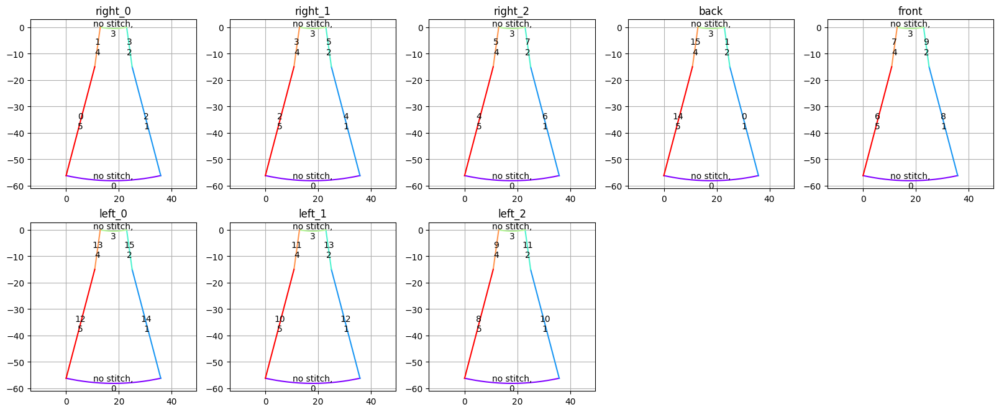

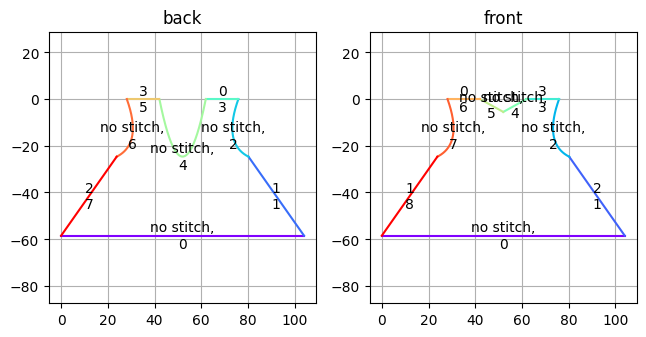

In [93]:
import random

IDX = random.randint(0, len(garment_path_list) - 1)
garment_path = garment_path_list[IDX]

print(IDX)
print(garment_path)

spec_config_path = os.path.join(garment_path, "static", "spec_config.json")
with open(spec_config_path, "r") as f:
    spec_config = json.load(open(spec_config_path, "r"))

pprint(spec_config)

spec_file_path_list = glob(os.path.join(garment_path, "static", "*specification.json"))

for spec_file_path in spec_file_path_list:
    pattern = pyg.pattern.wrappers.VisPattern(spec_file_path)

    drawn_pattern_list = list(map(
        lambda pannel_name : pattern._draw_a_panel(
            pannel_name, apply_transform=False, fill=True
        ),
        pattern.panel_order()
    ))
    
    panel_svg_path_dict = {
        panel_name : pattern._draw_a_panel(
            panel_name, apply_transform=False, fill=True
        )
        for panel_name in pattern.panel_order()
    }
    stitch_dict = {
        i : v for i, v in enumerate(pattern.pattern['stitches'])
    }

    FIGLEN = 4
    NCOLS = int(np.sqrt(len(panel_svg_path_dict)))
    NROWS = int(np.ceil(len(panel_svg_path_dict) / NCOLS))
    NCOLS = 5
    NROWS = 3

    plt.figure(figsize=(FIGLEN * NCOLS, FIGLEN * NROWS))
    for i, (panel_name, panel) in enumerate(panel_svg_path_dict.items()):
        ax = plt.subplot(NROWS, NCOLS, i + 1)
        ax.set_title(panel_name)
        plot_panel_info(
            ax, panel_name, panel_svg_path_dict, stitch_dict,
            N_SAMPLES=1000
        )
    # plt.savefig(f"{garment_id}_panel_vis.png")
    plt.show()

10523
/media/hjp/05aba9a7-0e74-4e54-9bc9-5f11b9c4c757/SewFactory/sewfactory/sewfactory/tee_sleeveless_QX2K7F6BQS_skirt_4_panels_UBUCWE7KM6


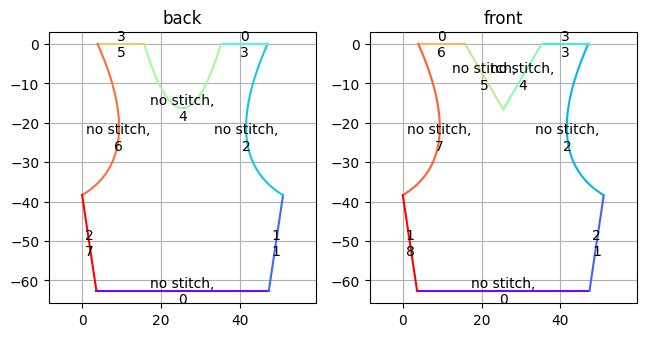

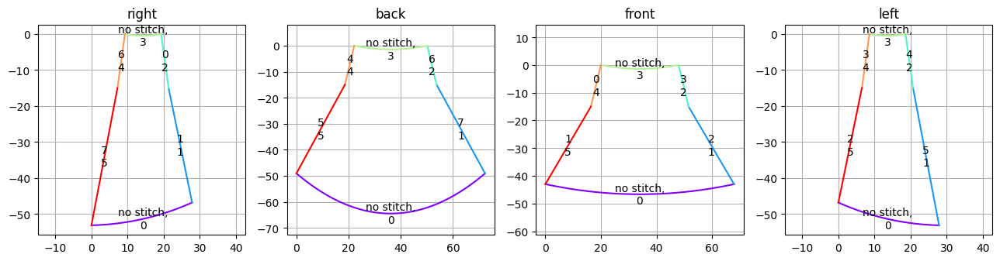

In [ ]:
import random

IDX = random.randint(0, len(combination_path_list) - 1)
combination_path = combination_path_list[IDX]

print(IDX)
print(combination_path)

spec_file_path_list = glob(os.path.join(combination_path, "static", "*specification.json"))

for spec_file_path in spec_file_path_list:
    pattern = pyg.pattern.wrappers.VisPattern(spec_file_path)

    drawn_pattern_list = list(map(
        lambda pannel_name : pattern._draw_a_panel(
            pannel_name, apply_transform=False, fill=True
        ),
        pattern.panel_order()
    ))
    
    panel_svg_path_dict = {
        panel_name : pattern._draw_a_panel(
            panel_name, apply_transform=False, fill=True
        )
        for panel_name in pattern.panel_order()
    }
    stitch_dict = {
        i : v for i, v in enumerate(pattern.pattern['stitches'])
    }

    FIGLEN = 4
    NCOLS = int(np.sqrt(len(panel_svg_path_dict)))
    NROWS = int(np.ceil(len(panel_svg_path_dict) / NCOLS))
    NCOLS = 5
    NROWS = 3

    plt.figure(figsize=(FIGLEN * NCOLS, FIGLEN * NROWS))
    for i, (panel_name, panel) in enumerate(panel_svg_path_dict.items()):
        ax = plt.subplot(NROWS, NCOLS, i + 1)
        ax.set_title(panel_name)
        plot_panel_info(
            ax, panel_name, panel_svg_path_dict, stitch_dict,
            N_SAMPLES=1000
        )
    # plt.savefig(f"{garment_id}_panel_vis.png")
    plt.show()
    


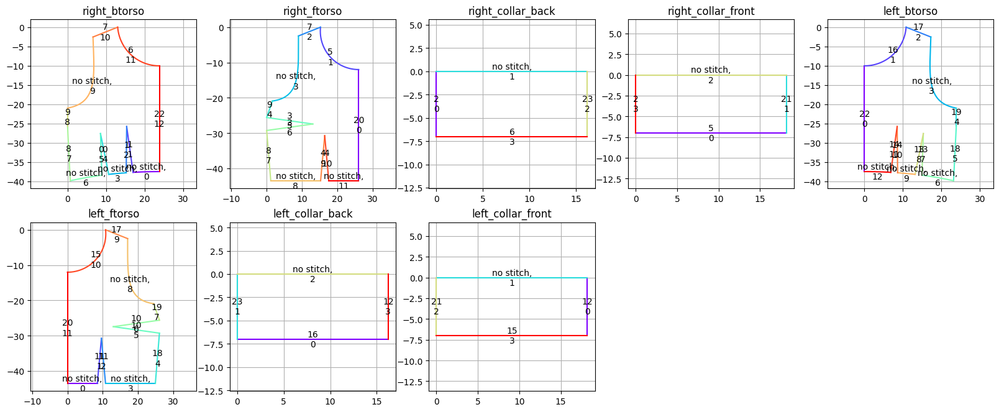

In [14]:
panel_svg_path_dict = {
    panel_name : pattern._draw_a_panel(
        panel_name, apply_transform=False, fill=True
    )
    for panel_name in pattern.panel_order()
}
stitch_dict = {
    i : v for i, v in enumerate(pattern.pattern['stitches'])
}

FIGLEN = 4
NCOLS = int(np.sqrt(len(panel_svg_path_dict)))
NROWS = int(np.ceil(len(panel_svg_path_dict) / NCOLS))
NCOLS = 5
NROWS = 3

plt.figure(figsize=(FIGLEN * NCOLS, FIGLEN * NROWS))
for i, (panel_name, panel) in enumerate(panel_svg_path_dict.items()):
    ax = plt.subplot(NROWS, NCOLS, i + 1)
    ax.set_title(panel_name)
    plot_panel_info(
        ax, panel_name, panel_svg_path_dict, stitch_dict,
        N_SAMPLES=1000
    )
# plt.savefig(f"{garment_id}_panel_vis.png")
plt.show()

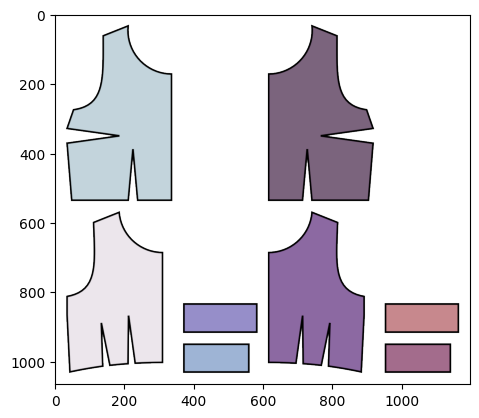

In [4]:
plt.imshow(Image.open(os.path.join(garment_path, f"{garment_id}_texture.png")))
plt.show()

# for i, (panel_name, panel) in enumerate(panel_svg_path_dict.items()):
#     fig, ax = plt.subplots()
#     ax.set_title(panel_name)
#     plot_panel_info(
#         ax, panel_name, panel_svg_path_dict, stitch_dict,
#         N_SAMPLES=1000
#     )
#     plt.show()
# for i, (panel_name, panel) in enumerate(panel_svg_path_dict.items()):
#     fig, ax = plt.subplots()
#     ax.set_title(panel_name)
#     plot_panel_info(
#         ax, panel_name, panel_svg_path_dict, stitch_dict,
#         N_SAMPLES=1000
#     )
#     plt.show()


In [5]:

simulated_garment_mesh = trimesh.load_mesh(
    os.path.join(garment_path, f"{garment_id}_sim.ply"),
    process=False
)
simulated_garment_mesh.vertices = simulated_garment_mesh.vertices / 100


tex_image = Image.open(os.path.join(garment_path, f"{garment_id}_texture.png"))
texture = trimesh.visual.TextureVisuals(
    simulated_garment_mesh.visual.uv,
    image=tex_image
)
simulated_garment_mesh.visual = texture

print("vertices", simulated_garment_mesh.vertices.shape)
print("faces", simulated_garment_mesh.faces.shape)

idx_convert_map = np.array(v_id_map(simulated_garment_mesh.vertices))

# Read Vertex Label
with open(os.path.join(garment_path, f"{garment_id}_sim_segmentation.txt"), "r") as f:
    segmentation = list(map(
        lambda x : x.strip(),
        f.readlines()
    ))

panel_vertex_mask_dict = {}
for k in panel_svg_path_dict.keys():
    raw_mask = list(map(
        lambda x : True if x.startswith(k) else False,
        segmentation
    ))
    panel_vertex_mask_dict[k] = np.array(list(map(
        lambda idx : True if raw_mask[idx] else False,
        idx_convert_map
    )))
    

stitch_vertex_mask_dict = {}
for k in stitch_dict.keys():
    raw_mask = list(map(
        lambda x : True if f"stitch_{k}" in x.split(",") else False,
        segmentation
    ))
    base_mask = np.array(list(map(
        lambda idx : True if raw_mask[idx] else False,
        idx_convert_map
    )))
    stitch_vertex_mask_dict[k] = base_mask
    
    
# visualize_meshes_plotly(
#     [
#         simulated_garment_mesh,
#         default_body_mesh
#     ],
#     color_list=["red", "blue"],
#     vertices_list=[
#         simulated_garment_mesh.vertices[
#             # panel_vertex_mask_dict["left_ftorso"]
#             stitch_vertex_mask_dict[24]
#         ]
#     ],
#     vertices_color_list=["yellow"],
# )

vertices (4610, 3)
faces (8320, 3)


In [6]:
for k, v in stitch_dict.items():
    panels = [v[0]['panel'], v[1]['panel']]
    if "left_ftorso" in panels and "right_ftorso" in panels:
        print(k)

20


In [7]:

box_mesh = trimesh.load_mesh(
    os.path.join(garment_path, f"{garment_id}_boxmesh.ply"),
    process=False
)
box_mesh.vertices = box_mesh.vertices / 100


tex_image = Image.open(os.path.join(garment_path, f"{garment_id}_texture.png"))
texture = trimesh.visual.TextureVisuals(
    box_mesh.visual.uv,
    image=tex_image
)
box_mesh.visual = texture

print("vertices", box_mesh.vertices.shape)
print("faces", box_mesh.faces.shape)

idx_convert_map = np.array(v_id_map(box_mesh.vertices))

# visualize_meshes_plotly(
#     [
#         box_mesh,
#         default_body_mesh
#     ],
#     color_list=["red", "blue"],
#     # vertex_list=simulated_garment_mesh.vertices[stitch_vertex_mask_dict[0]]
#     # vertex_list=simulated_garment_mesh.vertices[panel_vertex_mask_dict["left_ftorso"]]
#     vertices_list=[box_mesh.vertices],
#     vertices_color_list = ["black"]
# )

vertices (4610, 3)
faces (8320, 3)


In [8]:
QUERY_VERTEX_IDX = idx_convert_map.max()
QUERY_VERTEX_IDX = 5
same_vertex_idx_list = []

filtered_vertex_idx = idx_convert_map[QUERY_VERTEX_IDX]

same_vertex_idx_list = np.where(
    np.array(idx_convert_map) == filtered_vertex_idx
)[0]
print("QUERY_VERTEX_IDX    ", QUERY_VERTEX_IDX)
print("filtered_vertex_idx ", filtered_vertex_idx)
print("same_vertex_idx_list", same_vertex_idx_list)

print(idx_convert_map[same_vertex_idx_list])
print(idx_convert_map[QUERY_VERTEX_IDX])
print(idx_convert_map[:QUERY_VERTEX_IDX + 1])

QUERY_VERTEX_IDX     5
filtered_vertex_idx  3
same_vertex_idx_list [5 6]
[3 3]
3
[0 1 1 2 2 3]


## Processing
- Some vertices (Stitch Vertices) are duplicated.
- I have to Reorder Seam Vertices Path 

In [9]:
full_vertices = np.array(simulated_garment_mesh.vertices)
full_edges = np.array(simulated_garment_mesh.edges)
full_faces = np.array(simulated_garment_mesh.faces)

filtered2full_idx_map = {}
for idx, filtered_idx in enumerate(idx_convert_map):
    if filtered_idx in filtered2full_idx_map :
        filtered2full_idx_map[filtered_idx].append(idx)
    else:
        filtered2full_idx_map[filtered_idx] = [idx]

filtered_idx_list = []
filtered_vertices = []
for full_idx, filtered_idx in enumerate(idx_convert_map):
    if filtered_idx in filtered_idx_list:
        continue
    filtered_idx_list.append(filtered_idx)
    filtered_vertices.append(full_vertices[full_idx])
filtered_vertices = np.array(filtered_vertices)

filtered_edges = []
for idx, orig_edge in enumerate(full_edges):
    filtered_edge = np.array([
        idx_convert_map[orig_edge[0]],
        idx_convert_map[orig_edge[1]]
    ])
    
    # if len(filtered_edges) == 0:
    #     filtered_edges.append(filtered_edge)
    #     continue
    
    # if not  np.logical_or(
    #     (np.array(filtered_edges) == filtered_edge[0]).sum(axis=1) == 1,
    #     (np.array(filtered_edges) == filtered_edge[1]).sum(axis=1) == 1
    # ).sum() :
    #     filtered_edges.append(filtered_edge)
    filtered_edges.append(filtered_edge)
filtered_edges = np.array(filtered_edges)

filtered_faces = []
for idx, orig_face in enumerate(full_faces):
    filtered_face = np.array([
        idx_convert_map[orig_face[0]],
        idx_convert_map[orig_face[1]],
        idx_convert_map[orig_face[2]]
    ])

    # if len(filtered_faces) == 0:
    #     filtered_faces.append(filtered_face)
    #     continue 
    
    # if not np.logical_or(
    #     (np.array(filtered_faces) == filtered_face[0]).sum(axis=1) == 1,
    #     (np.array(filtered_faces) == filtered_face[1]).sum(axis=1) == 1,
    #     (np.array(filtered_faces) == filtered_face[2]).sum(axis=1) == 1
    # ).sum() :
    #     filtered_faces.append(filtered_face)
    filtered_faces.append(filtered_face)

In [10]:
full_edges.shape, filtered_edges.shape

((24960, 2), (24960, 2))

## Make Filtered Mesh

In [11]:


full_vertices = np.array(simulated_garment_mesh.vertices)
full_edges = np.array(simulated_garment_mesh.edges)
full_faces = np.array(simulated_garment_mesh.faces)

filtered2full_idx_map = {}
for idx, filtered_idx in enumerate(idx_convert_map):
    if filtered_idx in filtered2full_idx_map :
        filtered2full_idx_map[filtered_idx].append(idx)
    else:
        filtered2full_idx_map[filtered_idx] = [idx]

filtered_edges = []
for orig_edge in full_edges:
    stt = idx_convert_map[orig_edge[0]]
    end = idx_convert_map[orig_edge[1]]
    filtered_edges.append([stt, end])
    # is_exists= False
    # for prev in filtered_edges:
    #     if (
    #         prev[0] == stt and prev[1] == end
    #     ) or (
    #         prev[0] == end and prev[1] == stt
    #     ):
    #         is_exists = True
    #         break
    # if not is_exists:
    #     filtered_edges.append([stt, end])
filtered_edges = np.array(filtered_edges)

filtered_faces = []
for idx, orig_face in enumerate(full_faces):
    
    v1, v2, v3 = sorted([
        idx_convert_map[orig_face[0]],
        idx_convert_map[orig_face[1]],
        idx_convert_map[orig_face[2]]
    ])
    filtered_faces.append([v1, v2, v3])
    # is_exists = False
    # for prev in filtered_faces:
    #     prev_v1, prev_v2, prev_v3 = sorted(prev)
        
    #     if prev_v1 == v1 and prev_v2 == v2 and prev_v3 == v3:
    #         is_exists = True
    #         break
    # if not is_exists:
    #     filtered_faces.append([v1, v2, v3])
    
filtered_faces = np.array(filtered_faces)


filtered_mesh = trimesh.Trimesh(
    vertices=filtered_vertices,
    edges=filtered_edges,
    faces=filtered_faces,
    process=False
)


filtered_stitch_vertex_mask_dict = {}
for stitch_idx in stitch_vertex_mask_dict.keys():
    filtered_stitch_vertex_mask_dict[stitch_idx] = np.array(
        [False] * len(filtered_vertices)
    )
    for orig_vert_idx, val in enumerate(stitch_vertex_mask_dict[stitch_idx]):
        if val:
            filtered_vert_idx = idx_convert_map[orig_vert_idx]
            filtered_stitch_vertex_mask_dict[stitch_idx][filtered_vert_idx] = True


STITCH_IDX = 0
visualize_meshes_plotly(
    [filtered_mesh,],
    vertices_list=[
        filtered_mesh.vertices[filtered_stitch_vertex_mask_dict[STITCH_IDX]]
    ],
    vertices_color_list=["red"],
    vertex_marker_size=5
)


In [12]:
fltrd_vis_seam_line_dict = {}
fltrd_stch_vert_edge_connect_dict = {}
for fltrd_stch_idx in filtered_stitch_vertex_mask_dict.keys():
    fltrd_stch_vert_map = filtered_stitch_vertex_mask_dict[fltrd_stch_idx]
    fltrd_stch_vert_idx_arr = np.where(fltrd_stch_vert_map)[0]
    
    adj_dict = {}
    for v1, v2 in filtered_edges:
        if v1 in fltrd_stch_vert_idx_arr and v2 in fltrd_stch_vert_idx_arr:
            if v1 not in adj_dict: adj_dict[v1] = set()
            if v2 not in adj_dict: adj_dict[v2] = set()
            adj_dict[v1].add(v2)
            adj_dict[v2].add(v1)
    
    endpoints = [
        v for v in fltrd_stch_vert_idx_arr if len(adj_dict.get(v, set())) == 1
    ]
    if len(endpoints) != 2:
        print(f"Warning: Found {len(endpoints)} endpoints, expected 2. Path may not be linear.")
        continue
    
    seam_vert_idx_list = [endpoints[0]]
    while len(seam_vert_idx_list) < len(fltrd_stch_vert_idx_arr):
        current_vert = seam_vert_idx_list[-1]
        neighbors = adj_dict[current_vert]
        next_vert = next((v for v in neighbors if v not in seam_vert_idx_list), None)
        if next_vert is None:
            break
        seam_vert_idx_list.append(next_vert)
    fltrd_vis_seam_line_dict[fltrd_stch_idx] = seam_vert_idx_list
    
    edge_connect_list = []
    for stt, end in zip(seam_vert_idx_list[:-1], seam_vert_idx_list[1:]):
        edge_exist = np.any(
            np.logical_or(
                np.logical_and(
                    filtered_edges[:, 0] == stt,
                    filtered_edges[:, 1] == end
                ),
                np.logical_and(
                    filtered_edges[:, 0] == end,
                    filtered_edges[:, 1] == stt
                )
            )
        )
            
        if edge_exist == False:
            print(f"Missing edge between vertices {stt} and {end}")

        edge_connect_list.append(edge_exist)

    fltrd_stch_vert_edge_connect_dict[fltrd_stch_idx] = edge_connect_list

## Signed Distance Field

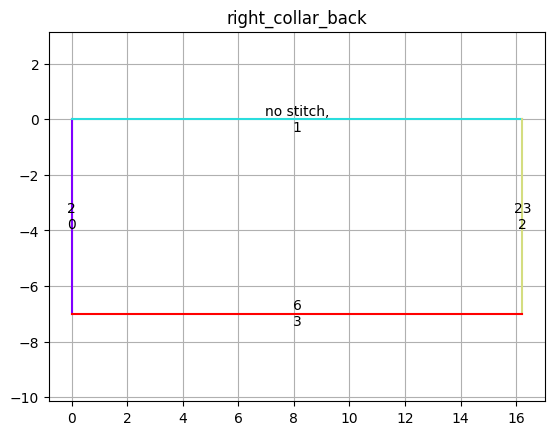

Path(Line(start=7j, end=0j),
     Line(start=0j, end=(16.226475637492708+0j)),
     Line(start=(16.226475637492708+0j), end=(16.226475637492708+7j)),
     Line(start=(16.226475637492708+7j), end=7j))


/home/hjp/anaconda3/envs/GarmentCode/lib/python3.9/site-packages/torch/functional.py:534: UserWarning:

torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3595.)



SCALE FACTOR :  9.735885382495624


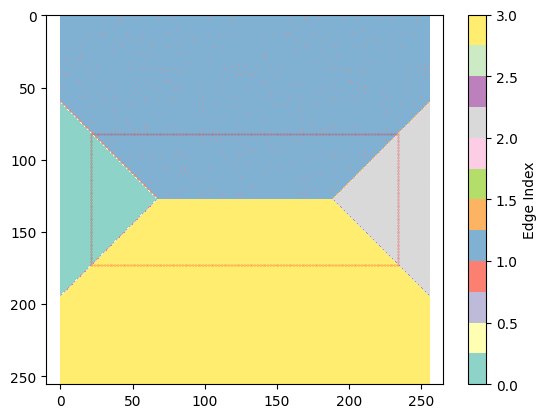

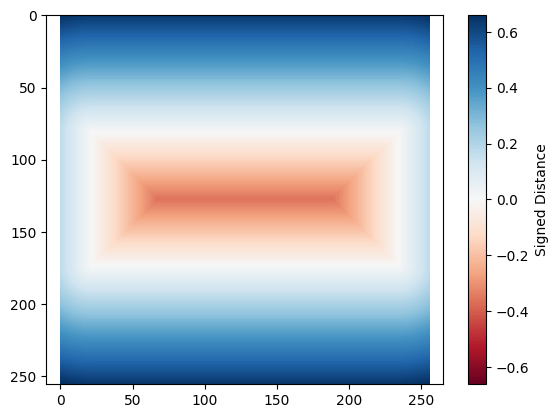

In [13]:
import svgpathtools
from svgpathtools import Path, Line
from matplotlib.colors import CenteredNorm
import time

def is_point_inside_path(path: Path, point: complex) -> bool:
    """
    Determine if a point is inside the path using ray casting.
    """
    ray_end = point + 1000 + 0j  # Cast ray in positive x direction
    intersections = 0
    
    for segment in path:
        ray = Line(point, ray_end)
        crossings = segment.intersect(ray)
        # crossings returns list of (t1, t2) tuples
        # t1 is parameter for first curve, t2 for second curve
        # We only care about t1 values between 0 and 1
        intersections += sum(1 for t1, t2 in crossings if 0 <= t1 <= 1)
    
    return intersections % 2 == 1

def compute_signed_distance_grid(
    path: svgpathtools.Path,
    n_samples: int = 1000,
    grid_size: int = 200,
    SDF_DOMAIN_SIZE: float = 2,
    ZOOM_OUT_FACTOR: float = 1.2,
    K_NEIGHBORS: int = 5
) -> torch.Tensor:
    """
    Compute signed distance field for an SVG path.
    args :
        path : svgpathtools.Path
            unnormalized closed path
        n_samples : int, number of samples along the path

        img_size : int, size of the grid
    """
    edge_lengths = [segment.length() for segment in path]
    total_length = sum(edge_lengths)
    
    # Distribute points proportionally to edge lengths
    points_per_edge = [
        max(int(n_samples * length / total_length), 10)  # Ensure minimum 10 points per edge
        for length in edge_lengths
    ]
    
    edge_points = []
    for edge_idx, segment in enumerate(path):
        t_vals = torch.linspace(0, 1, points_per_edge[edge_idx])
        edge_samples = torch.tensor([
            [segment.point(t.item()).real, segment.point(t.item()).imag]
            for t in t_vals
        ])
        edge_points.append(edge_samples)
    
    # Combine all points and create edge index mapping
    boundary_points = torch.cat(edge_points, dim=0)
    edge_indices = torch.cat([
        torch.full((points_per_edge[i],), i, dtype=torch.int64)
        for i in range(len(path))
    ])
    
    # get bounding box of the path
    xmin, xmax, ymin, ymax = path.bbox()
    x_center = (xmin + xmax) / 2
    y_center = (ymin + ymax) / 2
    x_scale = xmax - xmin
    y_scale = ymax - ymin
    
    scale_factor = max(x_scale, y_scale) * ZOOM_OUT_FACTOR / SDF_DOMAIN_SIZE
    
    boundary_points_normalized = (
        boundary_points - torch.tensor([x_center, y_center])
    ) / scale_factor
     
    # get grid of evaluation points
    coords = torch.stack(torch.meshgrid(
        torch.linspace(-1, 1, grid_size),
        torch.linspace(-1, 1, grid_size)
    ), dim=-1).reshape(-1, 2)[:, [1, 0]].float()
    
    # Compute unsigned distances
    coords_expanded = coords.unsqueeze(1)
    points_expanded = boundary_points_normalized.unsqueeze(0)
    distances = torch.norm(coords_expanded - points_expanded, dim=2)
    unsigned_distances, min_indices = torch.min(distances, dim=1)
    
    k_distances, k_indices = torch.topk(
        distances, k=K_NEIGHBORS, dim=1, largest=False
    )
    k_edge_indices = edge_indices[k_indices]
    weights = 1.0 / (k_distances + 1e-6)

    n_edges = len(path)

    one_hot = torch.zeros(
        k_edge_indices.shape[0], K_NEIGHBORS, n_edges
    )
    one_hot.scatter_(2, k_edge_indices.unsqueeze(-1), 1)
    
    # Apply weights to votes
    weighted_votes = one_hot * weights.unsqueeze(-1)
    
    # Sum votes for each edge
    edge_votes = weighted_votes.sum(dim=1)
    
    # Get edge with maximum votes
    closest_edge_indices = edge_votes.argmax(dim=1)
    
    # closest_edge_indices = edge_indices[min_indices]
    
    # For sign computation, transform coords back to original space
    signs = torch.tensor([
        -1 if is_point_inside_path(
            path, complex(x.item(), y.item())
        ) else 1
        for x, y in coords * scale_factor + torch.tensor([x_center, y_center])
    ])
    signed_distances = unsigned_distances * signs
    
    return (
        signed_distances.reshape(grid_size, grid_size),
        closest_edge_indices.reshape(grid_size, grid_size),
        scale_factor
    )

IMG_SIZE = 256
N_SAMPLES = 4000
PATH_IDX = 2

panel_name = pattern.panel_order()[PATH_IDX]
panel_svg_path = panel_svg_path_dict[panel_name][0]

fig, ax = plt.subplots()
ax.set_title(f"{panel_name}")
plot_panel_info(
    ax, panel_name,
    panel_svg_path_dict,
    stitch_dict,
    N_SAMPLES=1000
)
plt.show()

pprint(panel_svg_path)

sd_grid, edge_indices_grid, scale_factor = compute_signed_distance_grid(
    panel_svg_path,
    n_samples=N_SAMPLES,
    grid_size=IMG_SIZE
)

print("SCALE FACTOR : ", scale_factor)

THRESHOLD = 0.005
grid_np = sd_grid.cpu().numpy()
boundary_mask = np.logical_and(grid_np < THRESHOLD, grid_np > -THRESHOLD)
boundary_y, boundary_x = np.where(boundary_mask)



plt.imshow(edge_indices_grid.cpu().numpy(), cmap='Set3')
plt.colorbar(label='Edge Index')
plt.scatter(boundary_x, boundary_y, c='r', s=0.01)
plt.axis('equal')
plt.show()

plt.imshow(grid_np, cmap='RdBu', norm=CenteredNorm())
plt.colorbar(label='Signed Distance')
plt.axis('equal')
# plt.scatter(boundary_x, boundary_y, c='r', s=0.01)
plt.show()
